In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import os
os.chdir("/dcs04/lieber/lcolladotor/spatialHPC_LIBD4035/spatial_hpc")
os.getcwd()

'/dcs04/lieber/lcolladotor/spatialHPC_LIBD4035/spatial_hpc'

# cell type annotation

In [3]:
adata_filt = ad.read_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")
adata_filt.shape #74216

(74216, 30790)

In [4]:
celltype_markers = pd.read_csv("snRNAseq_hpc/python_analysis/processed-data/Ayhan_2021_TableS2_binary.csv", index_col=0)

In [5]:
marker_overlap = celltype_markers.index.isin(adata_filt.var_names) #
sum(marker_overlap)
celltype_list = list(celltype_markers.index[marker_overlap])
len(celltype_list)

89

In [6]:
celltype_markers_filt = celltype_markers[marker_overlap]
celltype_markers_filt.columns

Index(['Astro', 'GC', 'Endo', 'GABA', 'Micro', 'OPC', 'Olig', 'Pyr'], dtype='object')

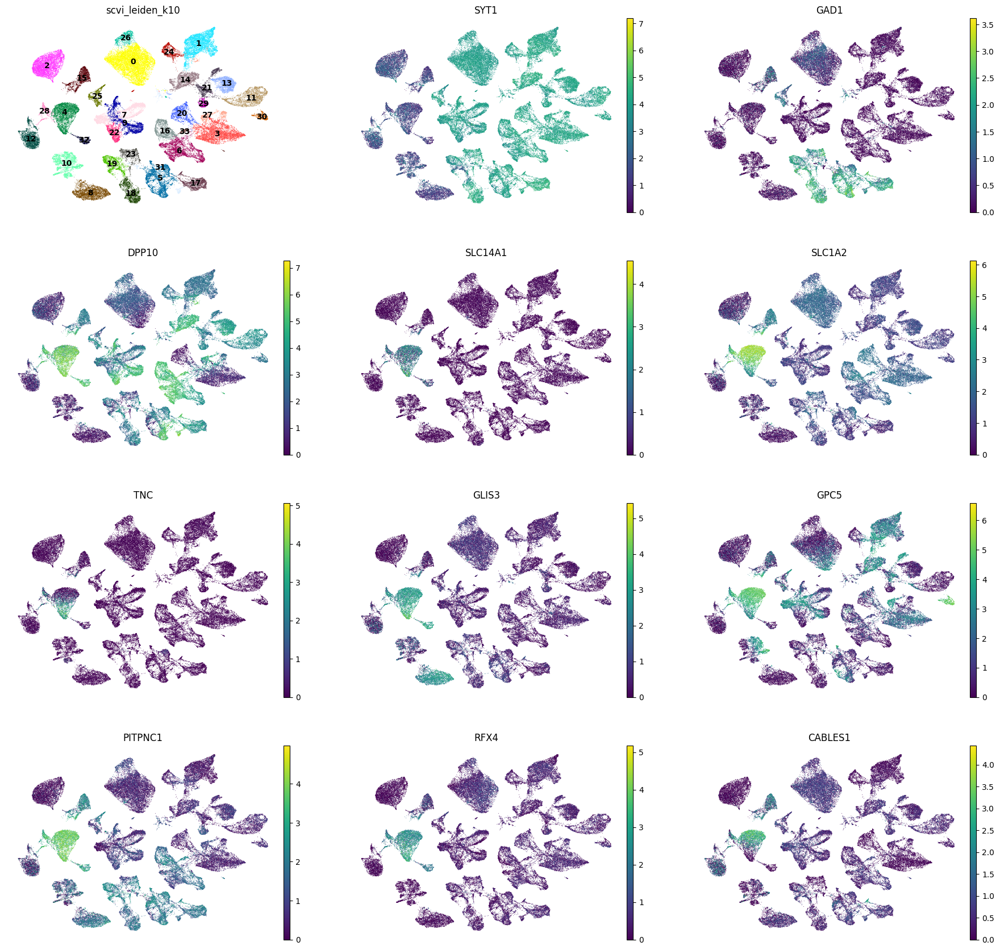

In [94]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.Astro==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# Astro: 4, 28, 32
# "RFX4","PITPNC1","TNC","CABLES1","SLC1A2",
# "GLIS3" #astro and choroid?

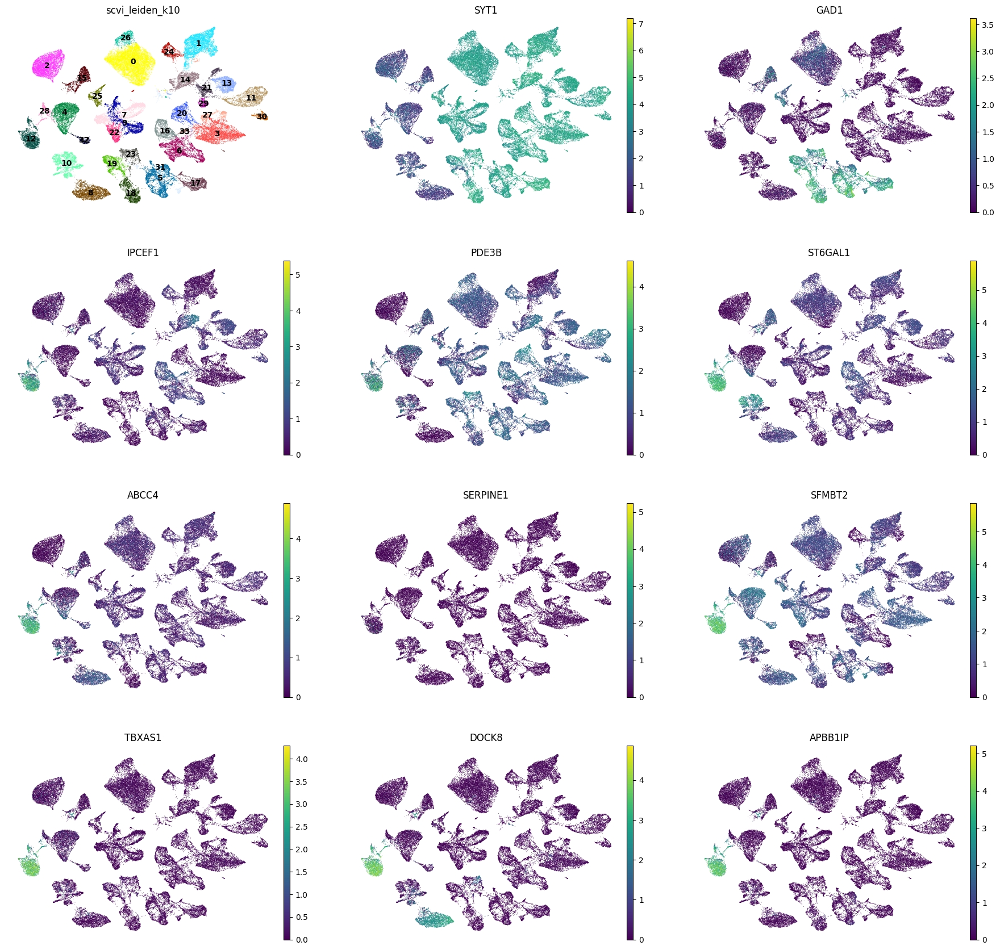

In [95]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.Micro==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# Micro: 12
# "SFMBT2","TBXAS1","APBB1IP",
# "DOCK8" #micro and choroid?

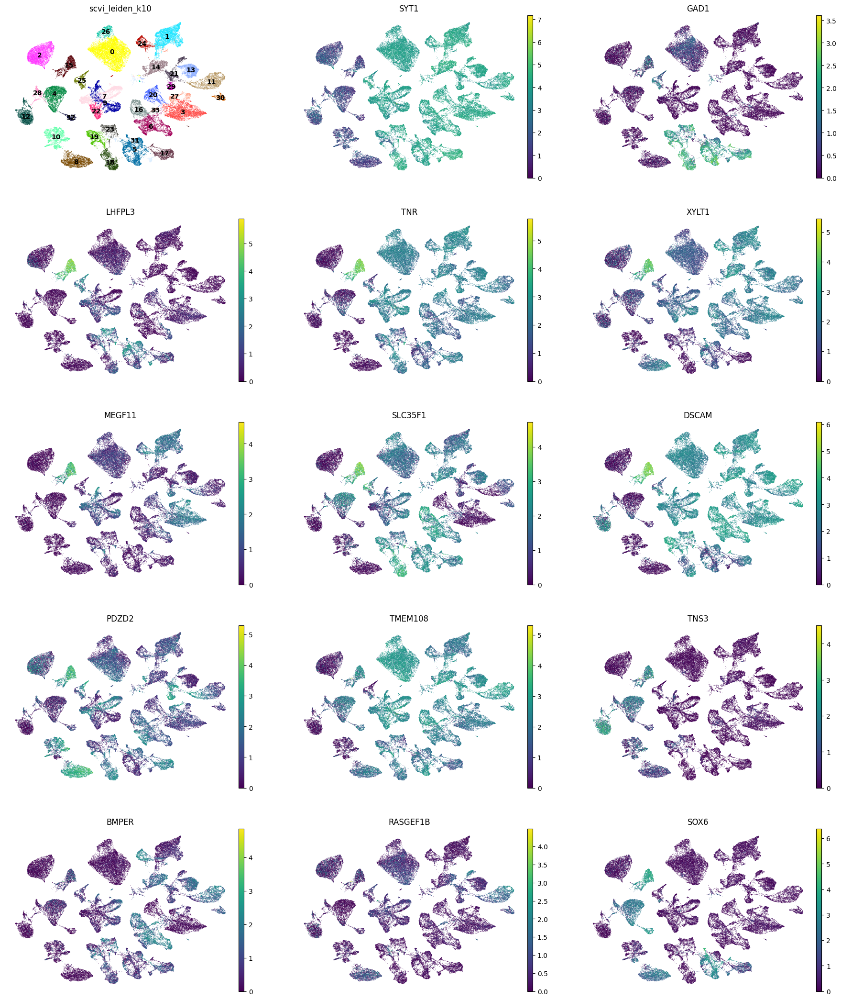

In [7]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.OPC==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# OPC: 15
# "LHFPL3","TNR","MEGF11"

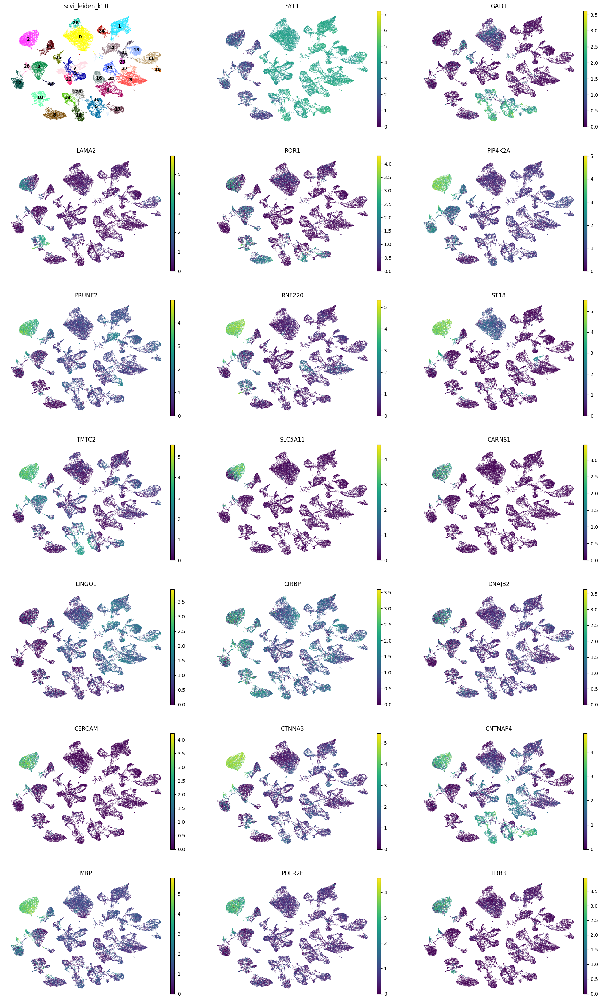

In [8]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.Olig==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# Olig: 2
# PIP4K2A, PRUNE2, RNF220, CERCAM, CTNNA3, MBP

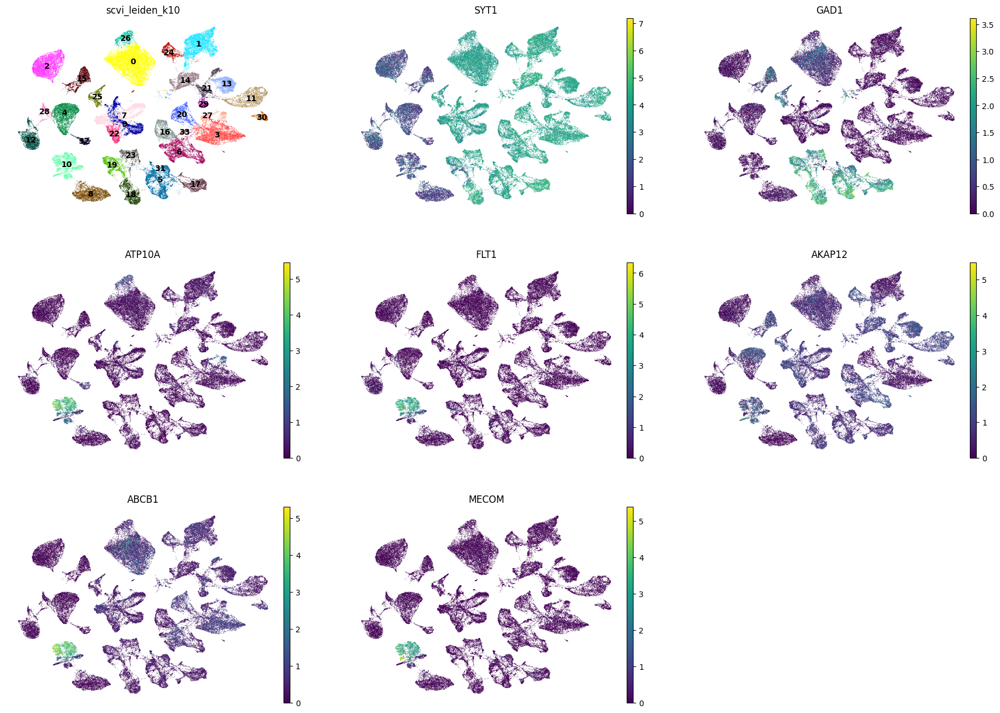

In [9]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.Endo==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# Endo: 10
# FLT1, ATP10A, ABCB1, MECOM

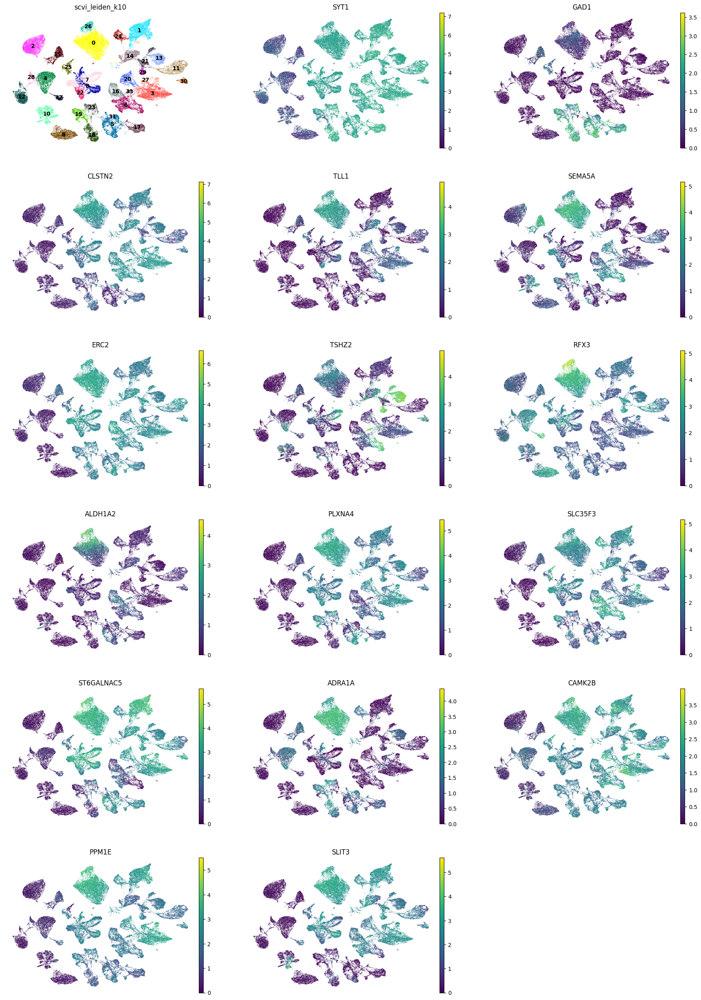

In [10]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.GC==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# GC: 0, 26 
# TLL1, SEMA5A, ADRA1A, RFX3 (imm)

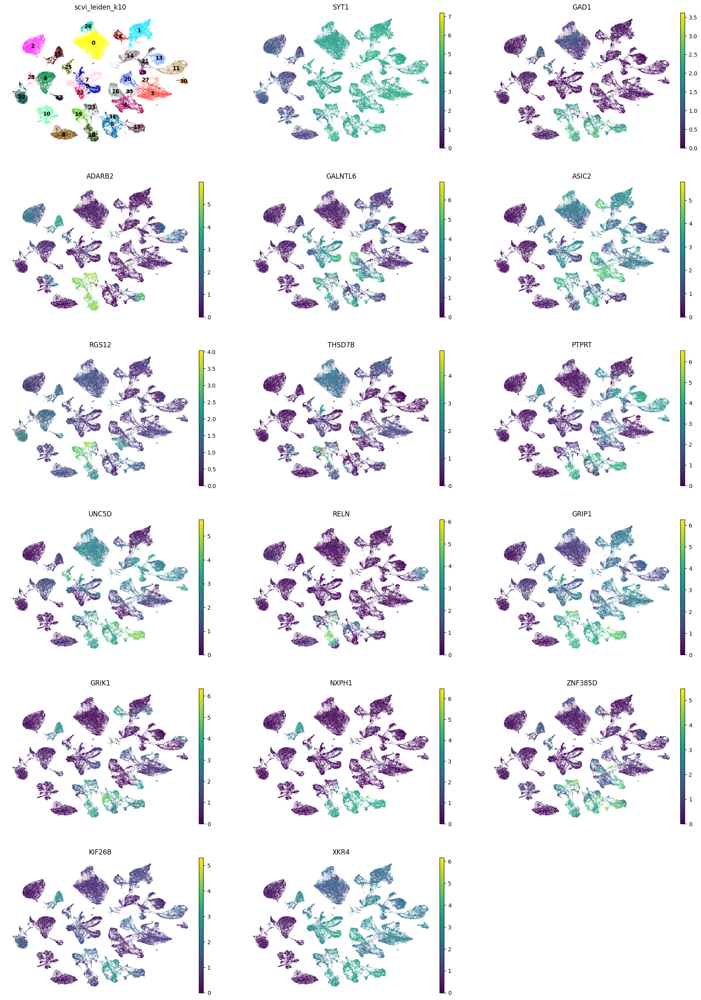

In [11]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.GABA==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# GABA: 17,18,19,23,31,5
# "GRIP1", "ZNF385D", "GAD1",#all
# "ADARB2","RSG12", "PTPRT", "NXPH1", "KIF26B" #different groupings
# "GRIK1" #all but 1-2 other cell pops (should be interesting)
# "CNR1" #cck

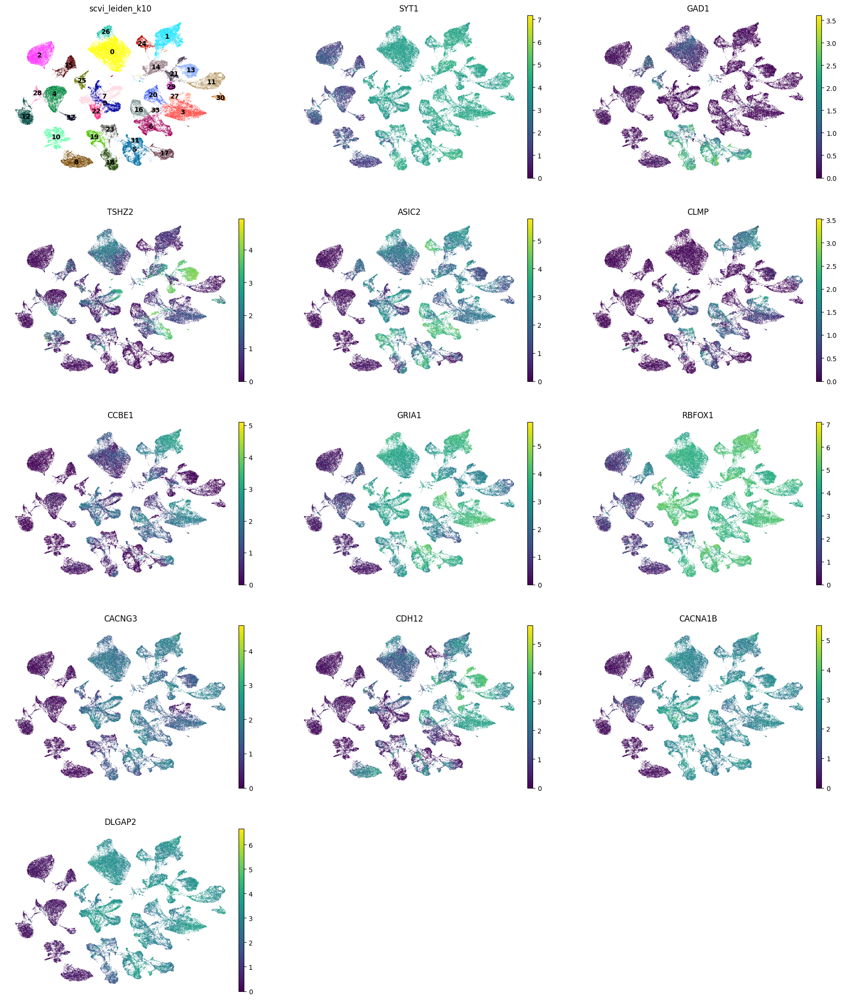

In [12]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+list(celltype_markers_filt[celltype_markers_filt.Pyr==1].index),
           ncols=3, legend_loc="on data", frameon=False)
# Pyr
# "TSHZ2" #some specific sub pops

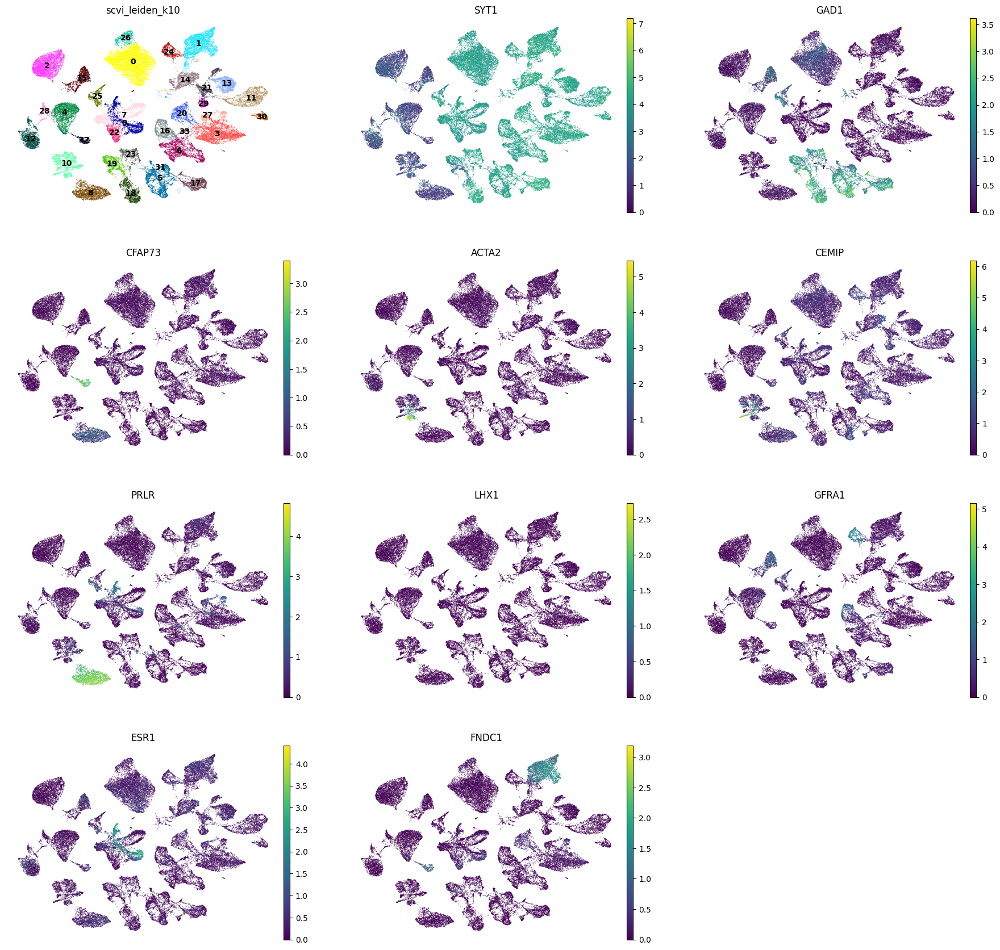

In [42]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+["CFAP73","ACTA2","CEMIP","PRLR","LHX1","GFRA1","ESR1","FNDC1"],
           ncols=3, legend_loc="on data", frameon=False)
# non pyramidal cell types with simple markers based on Figure 3
#ependymal: CFAP73 --> cluster 32
#PC/SMC(?): ACTA2 --> portion of cluster 10
#VLMC(?): CEMIP --> portion of cluster 10
#choroid plexus: PRLR --> cluster 8
#cajal retzius: LHX1 (non existant)

# hints as to clusters that might be...
#subiculum: gfra1 --> cluster 24
#hpc-amyg trans: esr1 --> cluster 9
#ca1: fndc1 --> cluster 1

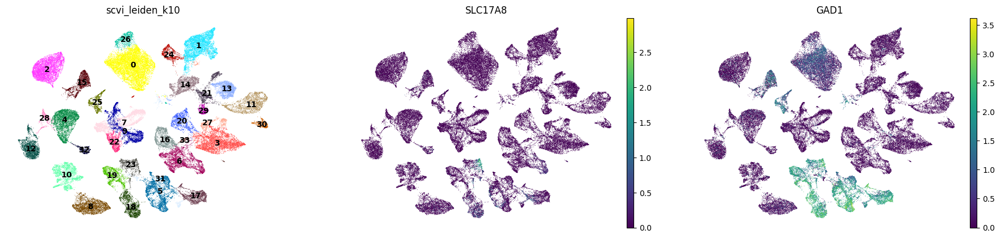

In [32]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SLC17A8","GAD1"], #SLC17A7
           ncols=3, legend_loc="on data", frameon=False)

"We identified 3 total capture areas from two donors containing tissue from adjacent amygdala based on expression of several genes known to be enriched in amygdala, including SLC17A6, CDH22 [21], OPRM1 [23], and CACNG4 [22] (Extended Data Fig. 14E-J)."

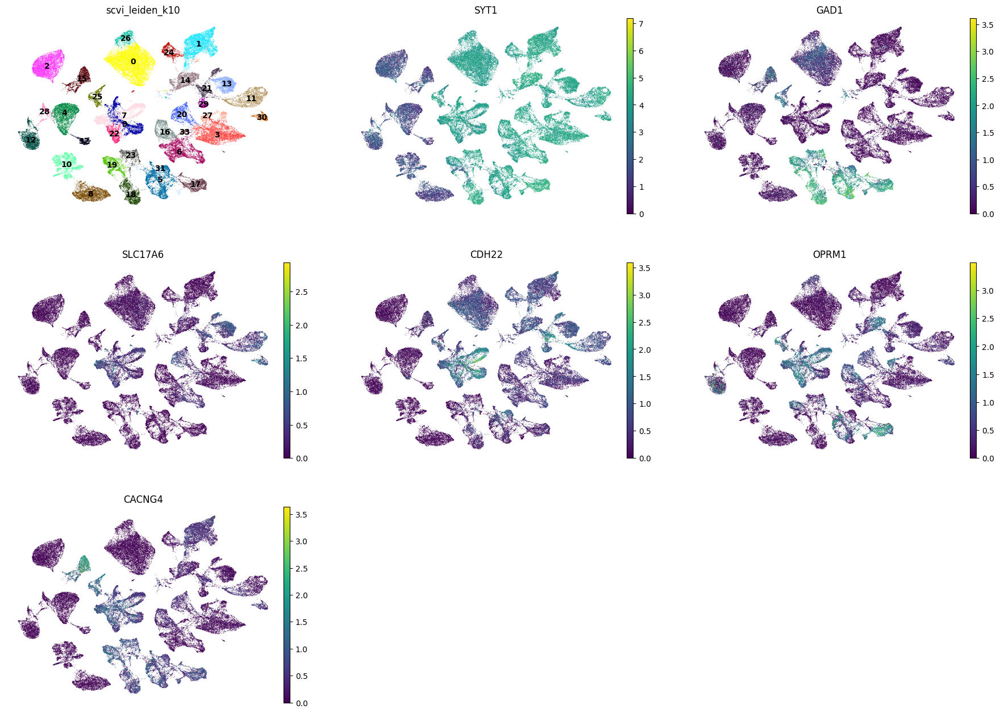

In [90]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","SYT1","GAD1"]+["SLC17A6","CDH22","OPRM1","CACNG4"],
           ncols=3, legend_loc="on data", frameon=False)

### Preliminary cell types

In [105]:
prelim_markers = [#"SFMBT2",
                    "TBXAS1","APBB1IP",
                  "DOCK8","PRLR","GLIS3",
                  "RFX4",#"PITPNC1",
                    "TNC","CABLES1",#"SLC1A2",
                  "CFAP73",
                  "FLT1", "ATP10A", #"ABCB1", 
                    "MECOM",
                  "PIP4K2A", #"PRUNE2", 
                    "RNF220", "CERCAM", "CTNNA3", "MBP",
                  "LHFPL3","MEGF11","TNR",
                  "SEMA5A","TLL1","ADRA1A", #"RFX3",
     'SLC17A7',
                  "GAD1","ZNF385D","GRIP1",
]
#SFMTB2, PITPNC1, SLC1A2, ABCB1, PRUNE2
#RFX3

In [45]:
sc.tl.dendrogram(adata_filt, groupby="scvi_leiden_k10", var_names=prelim_markers, optimal_ordering=True)

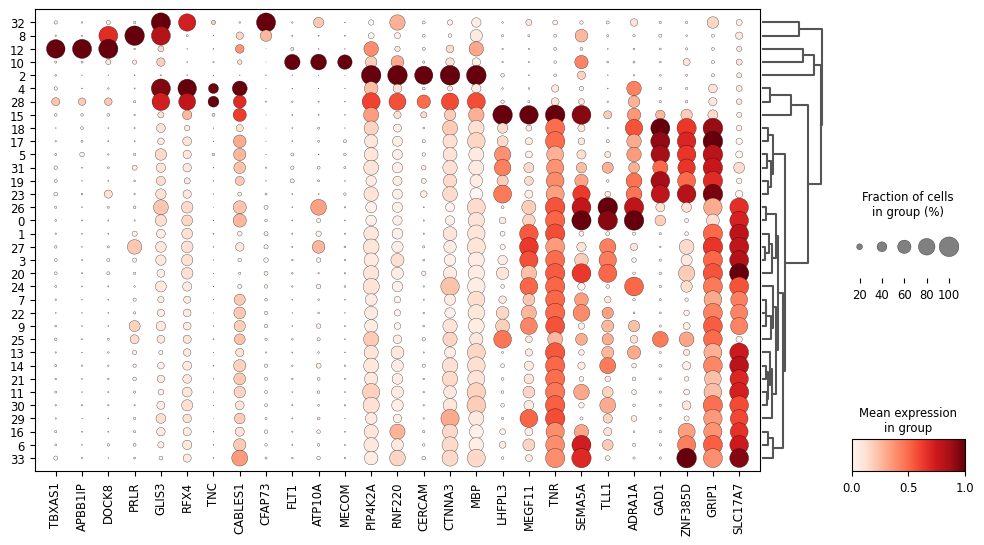

In [46]:
sc.pl.dotplot(adata_filt, prelim_markers, groupby="scvi_leiden_k10", standard_scale="var", dendrogram=True, figsize=(12,6))

In [5]:
adata_filt.obs['prelim_celltypes'] = "VGLUT1+"

In [6]:
#micro: 12 "SFMBT2","TBXAS1","APBB1IP",
### "DOCK8" micro and choroid
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='12',"prelim_celltypes"] = "microglia"
#choroid plexus: PRLR --> cluster 8
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='8',"prelim_celltypes"] = "choroid"
# Astro: 4, 28 "RFX4","PITPNC1","TNC","CABLES1","SLC1A2",
### "GLIS3" #astro and choroid?
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['4','28']),"prelim_celltypes"] = "astrocyte"
#ependymal: CFAP73 --> cluster 32
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='32',"prelim_celltypes"] = "ependymal"

# Endo: 10 # FLT1, ATP10A, ABCB1, MECOM
### PC/SMC(?): ACTA2 --> portion of cluster 10
### VLMC(?): CEMIP --> portion of cluster 10
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='10',"prelim_celltypes"] = "endothelial"

#olig: 2 PIP4K2A, PRUNE2, RNF220, CERCAM, CTNNA3, MBP
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='2',"prelim_celltypes"] = "oligodendrocyte"
#opc: 15 "LHFPL3","MEGF11","TNR",
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='15',"prelim_celltypes"] = "OPC"


# GC: 0, 26 TLL1, SEMA5A, ADRA1A, RFX3 (imm)
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['0','26']),"prelim_celltypes"] = "DG GC"
# GABA: 17,18,19,23,31,5 "GRIP1", "ZNF385D", "GAD1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['17','18','19','23','31','5']),"prelim_celltypes"] = "GABAergic"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='25',"prelim_celltypes"] = "VGLUT1-"

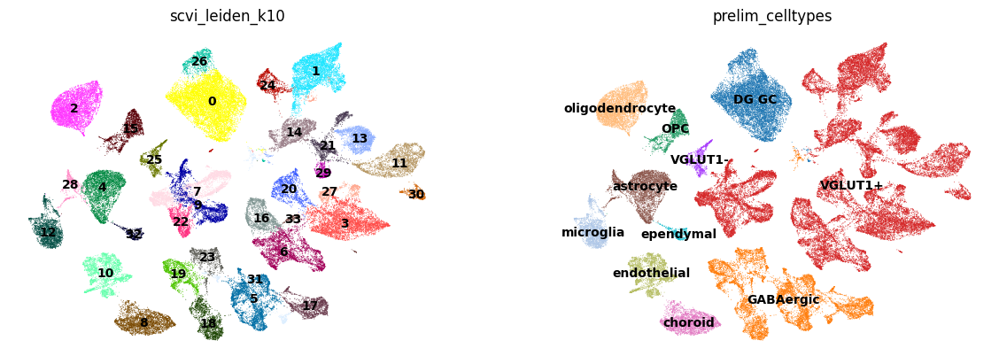

In [7]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","prelim_celltypes"],
           ncols=2, legend_loc="on data", frameon=False)

In [8]:
adata_filt.write_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")

# More detailed annotation

In [3]:
import seaborn as sns
import numpy as np

In [4]:
adata_filt = ad.read_h5ad("snRNAseq_hpc/python_analysis/processed-data/adata_qc-strict_scvi-2k-hdg_processed.h5")
adata_filt.shape #74216

(74216, 30790)

In [10]:
adata_nrn = adata_filt[adata_filt.obs['prelim_celltypes'].isin(['GABAergic','DG GC','VGLUT1-','VGLUT1+'])]
adata_nrn

View of AnnData object with n_obs × n_vars = 55108 × 30790
    obs: 'barcode', 'key', 'sample', 'tissue', 'brnum', 'round', 'sorted', 'id', 'dx', 'race', 'sex', 'age', 'pmi', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rnd_br_sort', '_scvi_batch', '_scvi_labels', 'scvi_leiden', 'scvi_leiden_k10', 'prelim_celltypes'
    var: 'n_cells', 'highly_deviant'
    uns: 'dendrogram_prelim_celltypes', 'dendrogram_scvi_leiden_k10', 'log1p', 'prelim_celltypes_colors', 'scvi_leiden_k10_colors'
    obsm: 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'scvi_latent'
    layers: 'counts', 'log1p_norm'
    obsp: 'connectivities', 

In [150]:
prelim_markers2 = ["CALB1",#"SLC17A7","GAD1",
                   #other GABA markers: NXPH1, GRIK1, RELN, ADARB2, RGS12, CNR1 are all from Ayhan
                   # I added C1QL1, LHX6, TAC1 based on this paper/figure https://www.nature.com/articles/s41586-018-0654-5/figures/5
                   ### more on TAC1 C1QL1 https://www.nature.com/articles/s41467-020-20328-4
                   # I added SST, CCK, ID2, NPY
                   "C1QL1","ID2","NOS1","LHX6","TAC1","SST","NPY",
                   #"GRIK1",
                   "RELN",
                   #"ADARB2", "RGS12",
                   "VIP","CALB2","CCK","CNR1","PENK",
                   #PENK https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8210463/
                   "CDH22","OPRM1",#HAT, CDH22 Fig 4: https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   #"KCNQ5",
                   "TSPAN18","CARTPT",#CA3 markers from Erik's list
                   "RGS14",#CA2 marker from Erik's list 
                   #"MPPED1", #CA1 and cortical marker https://pubmed.ncbi.nlm.nih.gov/20503375/
                   "FNDC1","FIBCD1","COL5A2",#CA1 markers from Erik's list
                   #subiculum and prosubiclum, from: https://www.cell.com/cell-reports/fulltext/S2211-1247(20)30601-X
                   "CBLN2",#subiculum pyramidal superficial
                   "FN1",# subiculum pyramidal
                   "CBLN4",#Prosubiculum pyramidal, superficial
                   "NTNG2",
                   "RORB",#L4 https://elifesciences.org/articles/52370.pdf
                   "SATB2", #callosal projection neurons https://pubmed.ncbi.nlm.nih.gov/18255030/
                   #SATB2 superficial cortical layers Fig 1 https://www.cell.com/neuron/fulltext/S0896-6273(07)01017-3
                   "CDH12",#Figure 6D https://www.sciencedirect.com/science/article/pii/S1567133X10000815?via%3Dihub
                   "TLE4",#corticothalamic neuron https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10542749/
                   "TBR1",
]
#"CUX2","SATB2","TLE4","FEZF2"

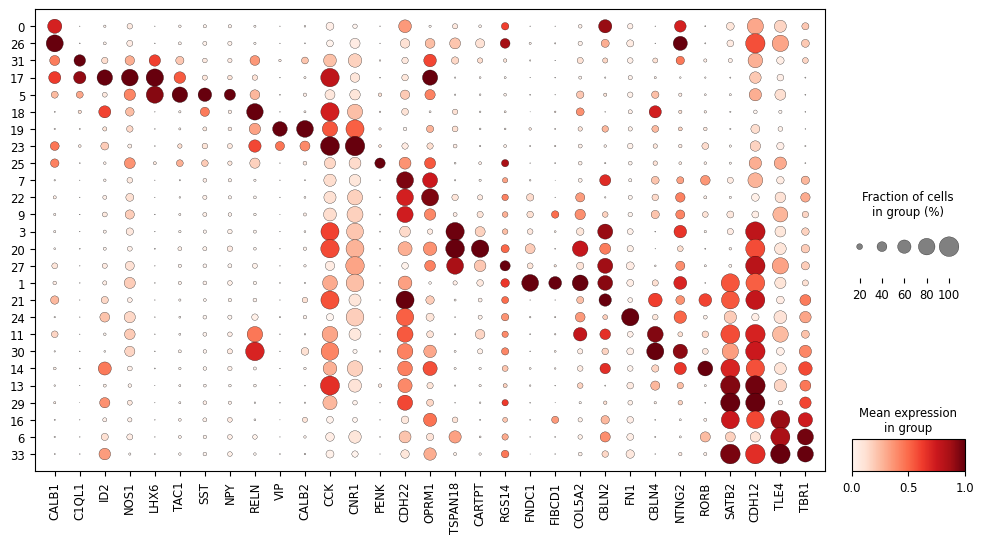

In [151]:
sc.pl.dotplot(adata_nrn, prelim_markers2, groupby="scvi_leiden_k10", standard_scale="var", 
              categories_order=jt_order_rev, figsize=(12,6))

In [94]:
jt_order_rev = [#'12','8','4','28','32','10','2','15',#glia
            '0','26',#GC
                #GABA
                '31',#C1qL1+, should be MGE derived?
                '17',#GABA MGE-derived, LHX6 pos, also UNC5D and NTN4+, ID2, Oprm1 (mu opiod receptor), NOS1
                '5',#GABA MGE-derived, SST+, TAC1+, NPY+
                '18',#GABA RELN, MPPED1+??
                '19', #GABA VIP CALB2
                '23',#GABA CCK #also SLC17A8+
                '25', #GABA PENK, maybe CA2 neurons b/c high expr of rgs14 https://onlinelibrary.wiley.com/doi/full/10.1002/hipo.22010?saml_referrer
            '7','22','9',#HATA: look at PZDZ2 and ESR1 to see differences
            '3','20',#CA3, 20 is CA3 with MC
                '27',#ca2
            '1',#ca1
            '21','24',#subiculum (21 pyramidal superifical, 24 subiculum
                '11','30',#prosubiculum both, 30 is NTNG2+
    '14',#L4 (rorb)
            '13','29', #superficial cortical layers
    '16','6','33', #deep layer cortical neurons
]

In [170]:
adata_filt.obs['detailed_celltypes'] = adata_filt.obs['prelim_celltypes'].astype('str')

In [171]:
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='31',"detailed_celltypes"] = "GABA_C1QL1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='17',"detailed_celltypes"] = "GABA_MGE_ID2.NOS1"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='5',"detailed_celltypes"] = "GABA_MGE_SST.TAC1.NPY"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='18',"detailed_celltypes"] = "GABA_RELN"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='19',"detailed_celltypes"] = "GABA_VIP.CALB2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='23',"detailed_celltypes"] = "GABA_CCK"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='25',"detailed_celltypes"] = "GABA_PENK"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['7','22','9']),"detailed_celltypes"] = "HAT"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='3',"detailed_celltypes"] = "CA3"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='20',"detailed_celltypes"] = "CA3_MC"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='27',"detailed_celltypes"] = "CA2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='1',"detailed_celltypes"] = "CA1"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='21',"detailed_celltypes"] = "SUB_CBLN2"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='24',"detailed_celltypes"] = "SUB_FN1"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='11',"detailed_celltypes"] = "PROS"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='30',"detailed_celltypes"] = "PROS_NTNG2"

adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10=='14',"detailed_celltypes"] = "EC_L4"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['13','29']),"detailed_celltypes"] = "EC_SUPERFICIAL"
adata_filt.obs.loc[adata_filt.obs.scvi_leiden_k10.isin(['16','6','33']),"detailed_celltypes"] = "EC_DEEP"

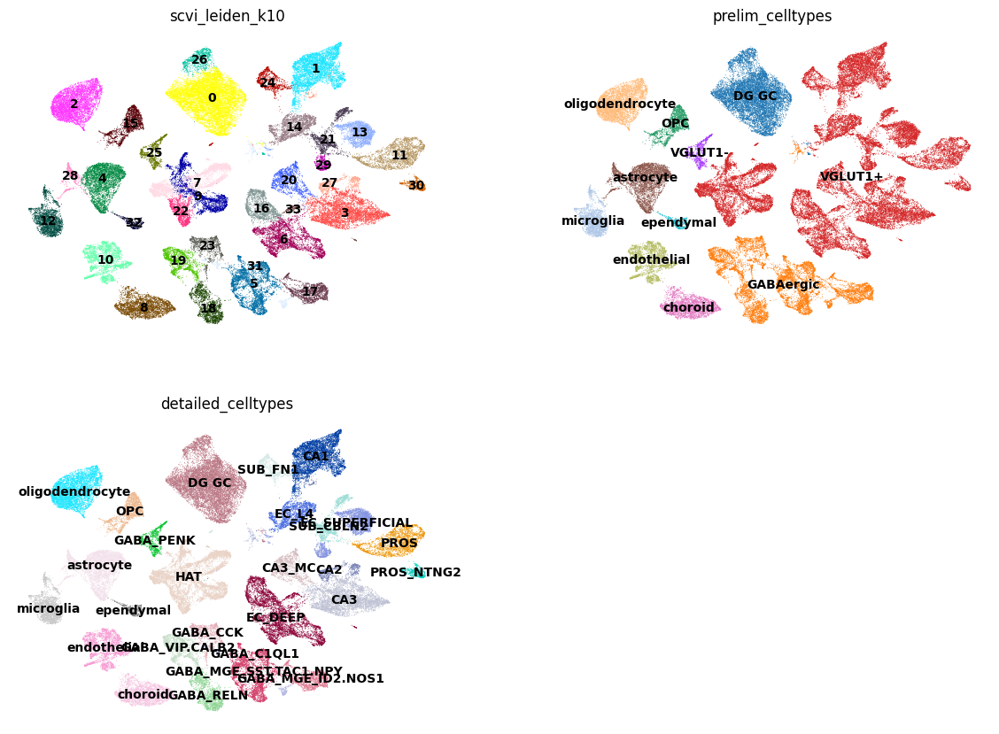

In [173]:
sc.pl.umap(adata_filt, color=["scvi_leiden_k10","prelim_celltypes","detailed_celltypes"],
           ncols=2, legend_loc="on data", frameon=False)

# Compare to Erik's assignment

In [174]:
mdata = pd.read_csv("snRNAseq_hpc/python_analysis/processed-data/colData_EN-final.csv", index_col=2)

In [175]:
adata_filt.obs['EN_final'] = adata_filt.obs.index.isin(mdata.index)
mdata['adata'] = mdata.index.isin(adata_filt.obs.index)

#### EN classes onto adata

In [12]:
adata_filt.obs['mid_cell_class'] = "none"
adata_filt.obs.loc[mdata[mdata.adata].index,'mid_cell_class'] = mdata[mdata.adata]["mid.cell.class"]

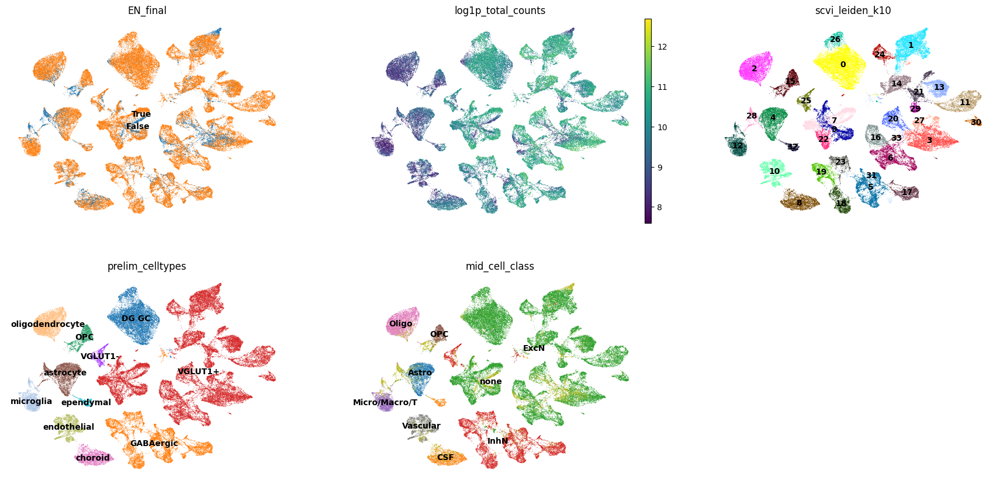

In [58]:
sc.pl.umap(adata_filt, color=["EN_final","log1p_total_counts","scvi_leiden_k10","prelim_celltypes","mid_cell_class"],
           ncols=3, legend_loc="on data", frameon=False)

Above: 
- Most nuclei present in this pipeline and absent from Erik's have low UMI counts
- Cluster 25 did not group with other GABAergic clusters in my dendrogram but also did not express VGLUT1 and is labeled as InhN in Erik's data set
- Ependymal cluster is assigned the same in both datasets, just grouped into CSF in Erik's mid cell class annotation

In [14]:
adata_filt.obs['fine_cell_class'] = "none"
adata_filt.obs.loc[mdata[mdata.adata].index,'fine_cell_class'] = mdata[mdata.adata]["fine.cell.class"]

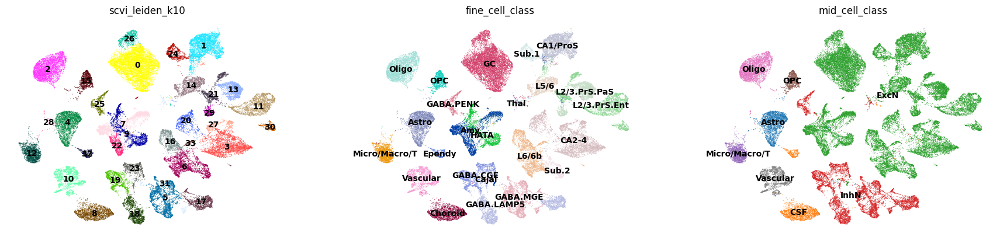

In [59]:
sc.pl.umap(adata_filt[adata_filt.obs.EN_final], color=["scvi_leiden_k10","fine_cell_class","mid_cell_class"],
           ncols=3, legend_loc="on data", frameon=False)

#### JT cell types onto EN

In [176]:
mdata['prelim'] = "none"
mdata.loc[mdata.adata,'prelim'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'prelim_celltypes']

mdata['detailed'] = "none"
mdata.loc[mdata.adata,'detailed'] = adata_filt.obs.loc[adata_filt.obs.EN_final,'detailed_celltypes']

In [177]:
overlap_df = mdata[mdata.adata]
test_df = overlap_df.groupby(["mid.cell.class","prelim"], observed=True).size().to_frame("n_cells")
test_df['log_cells'] = np.log10(test_df['n_cells'])
pivot = pd.pivot_table(test_df, values="log_cells",index=["prelim"], columns=["mid.cell.class"], fill_value=0)

<Axes: xlabel='mid.cell.class', ylabel='prelim'>

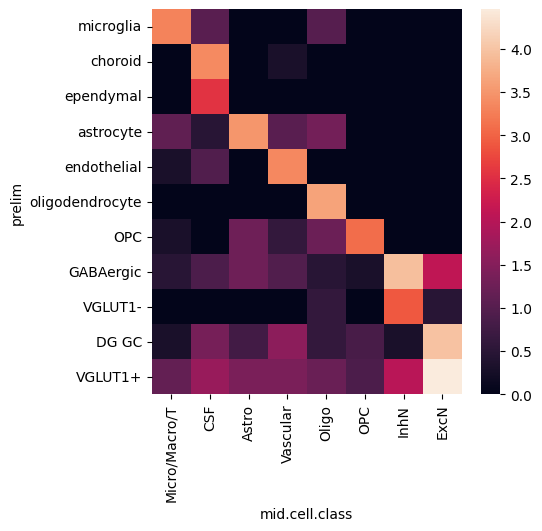

In [182]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.heatmap(pivot.loc[['microglia','choroid','ependymal','astrocyte','endothelial','oligodendrocyte','OPC',
                        'GABAergic','VGLUT1-','DG GC','VGLUT1+'],
['Micro/Macro/T','CSF','Astro','Vascular','Oligo','OPC','InhN','ExcN']])

In [186]:
test_df2 = overlap_df.groupby(["fine.cell.class","detailed"], observed=True).size().to_frame("n_cells")
test_df2['log_cells'] = np.log10(test_df2['n_cells'])
pivot2 = pd.pivot_table(test_df2, values="log_cells",index=["detailed"], columns=["fine.cell.class"], fill_value=0)

In [198]:
jt_order = ['microglia','choroid','ependymal','astrocyte','endothelial','oligodendrocyte','OPC',
            'DG GC',
            "GABA_C1QL1","GABA_MGE_SST.TAC1.NPY","GABA_MGE_ID2.NOS1","GABA_RELN","GABA_VIP.CALB2","GABA_CCK","GABA_PENK",
            "HAT","CA3","CA3_MC","CA2","CA1",
            "SUB_FN1","SUB_CBLN2","PROS","PROS_NTNG2",
            "EC_SUPERFICIAL","EC_L4","EC_DEEP"
           ]

In [195]:
en_order = ['Micro/Macro/T','Choroid','Ependy','Astro','Vascular','Oligo','OPC','GC',
            'Cajal','GABA.MGE','GABA.LAMP5','GABA.CGE','GABA.PENK',
            'Amy','HATA','Thal',
'CA2-4','CA1/ProS','Sub.1','Sub.2',
            'L2/3.PrS.Ent','L2/3.PrS.PaS',
           'L5/6','L6/6b']

<Axes: xlabel='fine.cell.class', ylabel='detailed'>

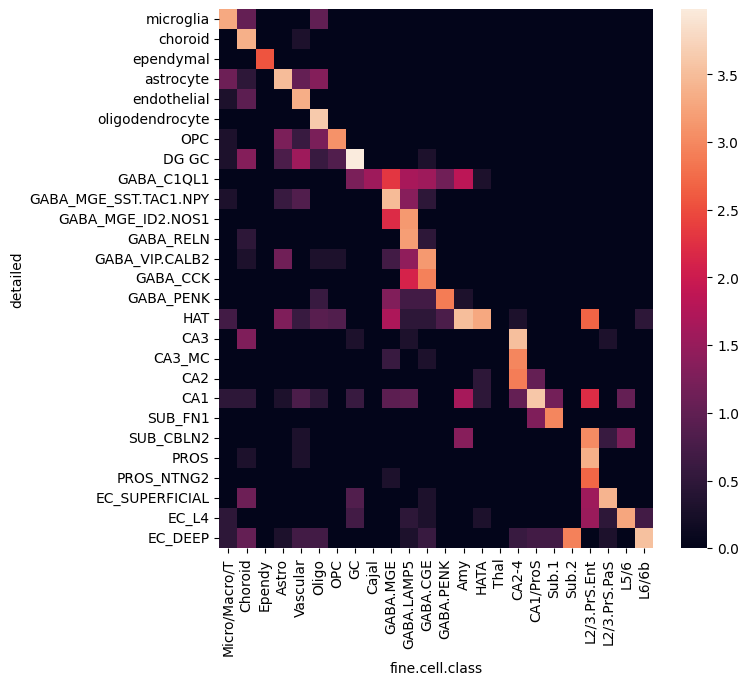

In [199]:
fig, ax = plt.subplots(figsize=(7, 7))
sns.heatmap(pivot2.loc[jt_order,en_order])